### EDA su dati da file in **formato Garmin fit**
* mostra come caricare un file in formato fit
* come calcolare alcune statistiche e plottare alcune serie temporali
* come visualizzare il percorso su una mappa interattiva

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

# maps
import folium

from utility import load_in_pandas_from_fit, plot_vs_altitude, compute_total_distance

#### Load the file in a DataFrame

In [2]:
POWER = True
CADENCE = True

FNAME = "file2.fit"

# specifying true we load also power and cadence
df = load_in_pandas_from_fit(FNAME, power=POWER, cadence=POWER)

df['timestamp'] = pd.to_datetime(df['timestamp'])

In [3]:
# tail or head?
df.tail(10)

,id,timestamp,position_lat,position_long,altitude,temperature,speed,distance,heart_rate,cadence,power,n_power
16965,16966,2019-05-12 15:09:41,43.727245,10.799408,-43.0,19,60.80,199633.0,175,101,409,367.7
16966,16967,2019-05-12 15:09:42,43.727100,10.799518,-43.0,19,61.31,199650.0,175,101,545,370.7
16967,16968,2019-05-12 15:09:43,43.726978,10.799622,-43.0,19,60.80,199667.0,175,101,379,371.1
16968,16969,2019-05-12 15:09:44,NaN,NaN,-43.0,19,58.61,199683.0,174,93,231,370.4
16969,16970,2019-05-12 15:09:45,NaN,NaN,-43.0,19,58.10,199700.0,174,93,231,367.0
16970,16971,2019-05-12 15:09:46,NaN,NaN,-43.0,19,57.82,199716.0,174,71,192,361.6
16971,16972,2019-05-12 15:09:47,NaN,NaN,-43.0,19,56.99,199732.0,174,96,366,365.6
16972,16973,2019-05-12 15:09:48,NaN,NaN,-43.0,19,56.30,199748.0,173,96,366,370.1
16973,16974,2019-05-12 15:09:49,NaN,NaN,-43.0,19,54.40,199763.0,173,96,366,370.4
16974,16975,2019-05-12 15:09:50,NaN,NaN,-43.0,19,52.70,199779.0,172,96,366,370.6


#### Compute Statistics

In [4]:
all_cols = df.columns
exc_cols = ['id','timestamp','position_lat','position_long']
allow_cols = list(set(all_cols) - set(exc_cols))
                  
df[allow_cols].describe()

,cadence,speed,distance,heart_rate,power,temperature,altitude,n_power
count,16975.000000,16975.000000,16975.000000,16975.000000,16975.000000,16975.000000,16975.000000,16975.000000
mean,79.414374,42.371465,98295.167717,150.008071,250.993284,16.852371,159.711281,329.541455
std,29.528476,12.492806,58497.897084,21.164449,167.421615,4.328191,198.355101,95.812010
min,0.000000,0.000000,0.000000,0.000000,0.000000,10.000000,-45.000000,0.000000
25%,75.000000,34.200000,44413.500000,138.000000,121.000000,13.000000,-5.000000,261.500000
50%,89.000000,43.810000,100741.000000,152.000000,254.000000,17.000000,102.000000,334.000000
75%,97.000000,50.510000,150469.000000,165.000000,368.000000,20.000000,246.000000,392.800000
max,146.000000,92.300000,199779.000000,191.000000,936.000000,25.000000,694.000000,713.600000


In [5]:
# remove when lat, long are nan
df = df.dropna()

# time elapsed
time_diff = df['timestamp'].iloc[-1] - df['timestamp'].iloc[0]

print(f"Elapsed time: {time_diff}")

# tot km
tot_km = round(compute_total_distance(df['position_lat'].values, df['position_long'].values)/1000., 2)

print(f"Tot km. travelled: {tot_km}")

Elapsed time: 0 days 04:45:20
Tot km. travelled: 204.8


#### Some plots

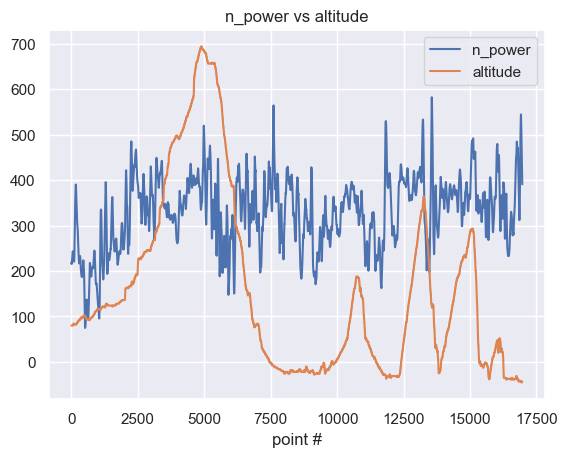

In [6]:
if POWER:
    plot_vs_altitude(df, col_name='n_power', smooth=True)

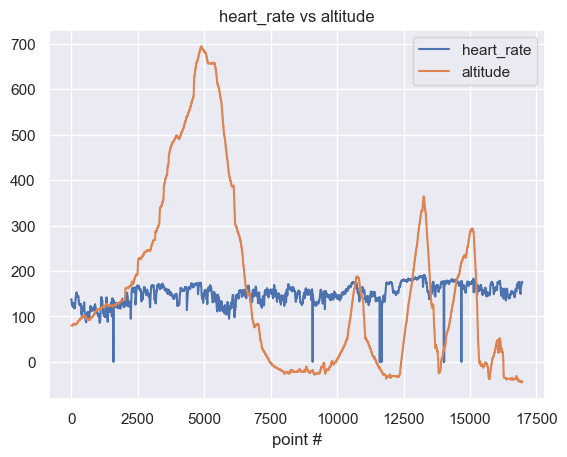

In [7]:
plot_vs_altitude(df, col_name='heart_rate')

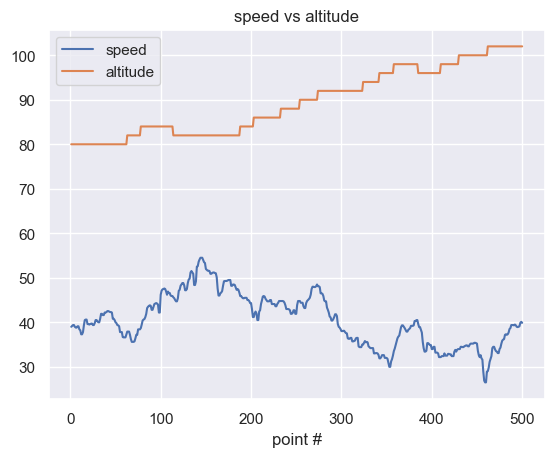

In [8]:
# to reduce # of points
plot_vs_altitude(df[:500], col_name='speed')

#### Displays trackpoints on a map

In [9]:
# remove eventually rows where lat, lon are nan
df = df.dropna()

m = folium.Map(location=[df['position_lat'][1], df['position_long'][1]], zoom_start=15)

# to create the popup
cols_list = ['position_lat', 'position_long', 'altitude', 'speed']
if POWER:
    cols_list.append('power')
if CADENCE:
    cols_list.append('cadence')
    
for i, row in df[cols_list].iterrows():
    f_str = f"<b>Altitude: {row['altitude']} m.</b><br><b>Speed: {row['speed']} kmh</b>"

    if POWER:
        f_str += f"<br><b>Power: {row['power']} w."
    if CADENCE:
        f_str += f"<br><b>Cadence: {row['cadence']}"
        
    popup_html = folium.Popup(f_str, max_width=200)
    
    folium.CircleMarker(location=[row['position_lat'], row['position_long']],
                        popup=popup_html,
                        radius=3).add_to(m)

n_rows = i

# add start (green) end (red)
folium.CircleMarker(
    location=[df['position_lat'][0], df['position_long'][0]],  # Latitude and Longitude
    radius=5,  # Size of the circle
    color='green',  # Border color of the circle
    fill=True,
    fill_color='green'  # Fill color of the circle
).add_to(m)
folium.CircleMarker(
    location=[df['position_lat'][n_rows], df['position_long'][n_rows]],  # Latitude and Longitude
    radius=5,  # Size of the circle
    color='red',  # Border color of the circle
    fill=True,
    fill_color='red'  # Fill color of the circle
).add_to(m)

# display the map
m